## Business  task and objectives

Analyze FitBit Fitness Tracker App data to gain insights into how consumers are using the FitBit app and discover trends and insights for the marketing team.<br>
Business Objectives:<br>
●	What are the trends identified?<br>
●	How could these trends apply to customers?<br>
●	How could these trends help influence marketing strategy?<br>
Deliverables:
1.	A clear summary of the business task
2.	A description of all data sources used
3.	Documentation of any cleaning or manipulation of data
4.	A summary of the analysis
5.	Supporting visualizations and key findings
6.	High-level content recommendations based on the analysis


Importing libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('darkgrid')
%matplotlib inline

## Data cleaning of the daily datasets individually

In [2]:
d_activity = pd.read_csv('dailyActivity_merged.csv')

In [3]:
d_activity.head()

,Id,ActivityDate,TotalSteps,TotalDistance,TrackerDistance,LoggedActivitiesDistance,VeryActiveDistance,ModeratelyActiveDistance,LightActiveDistance,SedentaryActiveDistance,VeryActiveMinutes,FairlyActiveMinutes,LightlyActiveMinutes,SedentaryMinutes,Calories
0,1503960366,4/12/2016,13162,8.50,8.50,0.0,1.88,0.55,6.06,0.0,25,13,328,728,1985
1,1503960366,4/13/2016,10735,6.97,6.97,0.0,1.57,0.69,4.71,0.0,21,19,217,776,1797
2,1503960366,4/14/2016,10460,6.74,6.74,0.0,2.44,0.40,3.91,0.0,30,11,181,1218,1776
3,1503960366,4/15/2016,9762,6.28,6.28,0.0,2.14,1.26,2.83,0.0,29,34,209,726,1745
4,1503960366,4/16/2016,12669,8.16,8.16,0.0,2.71,0.41,5.04,0.0,36,10,221,773,1863


In [4]:
d_activity.isna().sum()

Id                          0
ActivityDate                0
TotalSteps                  0
TotalDistance               0
TrackerDistance             0
LoggedActivitiesDistance    0
VeryActiveDistance          0
ModeratelyActiveDistance    0
LightActiveDistance         0
SedentaryActiveDistance     0
VeryActiveMinutes           0
FairlyActiveMinutes         0
LightlyActiveMinutes        0
SedentaryMinutes            0
Calories                    0
dtype: int64

No null values but i will convert ActivityDate into seperate columns

In [5]:
d_activity['ActivityDate'] = pd.to_datetime(d_activity['ActivityDate'])

In [6]:
d_activity['date'] = d_activity['ActivityDate'].dt.day
d_activity['month'] =d_activity['ActivityDate'].dt.month
d_activity['year'] = d_activity['ActivityDate'].dt.year
d_activity['day'] = d_activity['ActivityDate'].dt.day_name()

In [7]:
d_activity.drop(columns=['ActivityDate'], axis =1, inplace=True)

In [8]:
d_activity.head()

,Id,TotalSteps,TotalDistance,TrackerDistance,LoggedActivitiesDistance,VeryActiveDistance,ModeratelyActiveDistance,LightActiveDistance,SedentaryActiveDistance,VeryActiveMinutes,FairlyActiveMinutes,LightlyActiveMinutes,SedentaryMinutes,Calories,date,month,year,day
0,1503960366,13162,8.50,8.50,0.0,1.88,0.55,6.06,0.0,25,13,328,728,1985,12,4,2016,Tuesday
1,1503960366,10735,6.97,6.97,0.0,1.57,0.69,4.71,0.0,21,19,217,776,1797,13,4,2016,Wednesday
2,1503960366,10460,6.74,6.74,0.0,2.44,0.40,3.91,0.0,30,11,181,1218,1776,14,4,2016,Thursday
3,1503960366,9762,6.28,6.28,0.0,2.14,1.26,2.83,0.0,29,34,209,726,1745,15,4,2016,Friday
4,1503960366,12669,8.16,8.16,0.0,2.71,0.41,5.04,0.0,36,10,221,773,1863,16,4,2016,Saturday


In [9]:
d_calorie = pd.read_csv('dailyCalories_merged.csv')

In [10]:
d_calorie.head()

,Id,ActivityDay,Calories
0,1503960366,4/12/2016,1985
1,1503960366,4/13/2016,1797
2,1503960366,4/14/2016,1776
3,1503960366,4/15/2016,1745
4,1503960366,4/16/2016,1863


In [11]:
d_intensities = pd.read_csv('dailyIntensities_merged.csv')
d_steps = pd.read_csv('dailySteps_merged.csv')

In [12]:
d_intensities.head()

,Id,ActivityDay,SedentaryMinutes,LightlyActiveMinutes,FairlyActiveMinutes,VeryActiveMinutes,SedentaryActiveDistance,LightActiveDistance,ModeratelyActiveDistance,VeryActiveDistance
0,1503960366,4/12/2016,728,328,13,25,0.0,6.06,0.55,1.88
1,1503960366,4/13/2016,776,217,19,21,0.0,4.71,0.69,1.57
2,1503960366,4/14/2016,1218,181,11,30,0.0,3.91,0.40,2.44
3,1503960366,4/15/2016,726,209,34,29,0.0,2.83,1.26,2.14
4,1503960366,4/16/2016,773,221,10,36,0.0,5.04,0.41,2.71


In [13]:
d_steps.head()

,Id,ActivityDay,StepTotal
0,1503960366,4/12/2016,13162
1,1503960366,4/13/2016,10735
2,1503960366,4/14/2016,10460
3,1503960366,4/15/2016,9762
4,1503960366,4/16/2016,12669


In [14]:
##d_activity.to_csv('final_dailyactivity.csv',index=False)

We can see the data of d_calorie, d_intensities,d_steps were already present inside the d_activity.csv dataset.

I will make one-one csv file for hourly and minute data taking d_activity as a refrence.

## Hourly Datasets

In [15]:
h_calorie = pd.read_csv('hourlyCalories_merged.csv')
h_intensity = pd.read_csv('hourlyIntensities_merged.csv')
h_steps = pd.read_csv('hourlySteps_merged.csv')

In [17]:
h_calorie.head()

,Id,ActivityHour,Calories
0,1503960366,4/12/2016 12:00:00 AM,81
1,1503960366,4/12/2016 1:00:00 AM,61
2,1503960366,4/12/2016 2:00:00 AM,59
3,1503960366,4/12/2016 3:00:00 AM,47
4,1503960366,4/12/2016 4:00:00 AM,48


In [18]:
h_intensity.head()

,Id,ActivityHour,TotalIntensity,AverageIntensity
0,1503960366,4/12/2016 12:00:00 AM,20,0.333333
1,1503960366,4/12/2016 1:00:00 AM,8,0.133333
2,1503960366,4/12/2016 2:00:00 AM,7,0.116667
3,1503960366,4/12/2016 3:00:00 AM,0,0.000000
4,1503960366,4/12/2016 4:00:00 AM,0,0.000000


In [19]:
h_steps.head()

,Id,ActivityHour,StepTotal
0,1503960366,4/12/2016 12:00:00 AM,373
1,1503960366,4/12/2016 1:00:00 AM,160
2,1503960366,4/12/2016 2:00:00 AM,151
3,1503960366,4/12/2016 3:00:00 AM,0
4,1503960366,4/12/2016 4:00:00 AM,0


All hourly dataset have date and time combined in ActivityHour.

In [20]:
def split_datetime(df, column):
    df[column] = pd.to_datetime(df[column], format="%m/%d/%Y %I:%M:%S %p")
    df['date'] = df[column].dt.day
    df['month'] = df[column].dt.month
    df['year'] = df[column].dt.year
    df['time'] = df[column].dt.time
    
    return df

In [21]:
split_datetime(h_calorie, 'ActivityHour')

,Id,ActivityHour,Calories,date,month,year,time
0,1503960366,2016-04-12 00:00:00,81,12,4,2016,00:00:00
1,1503960366,2016-04-12 01:00:00,61,12,4,2016,01:00:00
2,1503960366,2016-04-12 02:00:00,59,12,4,2016,02:00:00
3,1503960366,2016-04-12 03:00:00,47,12,4,2016,03:00:00
4,1503960366,2016-04-12 04:00:00,48,12,4,2016,04:00:00
...,...,...,...,...,...,...,...
22094,8877689391,2016-05-12 10:00:00,126,12,5,2016,10:00:00
22095,8877689391,2016-05-12 11:00:00,192,12,5,2016,11:00:00
22096,8877689391,2016-05-12 12:00:00,321,12,5,2016,12:00:00
22097,8877689391,2016-05-12 13:00:00,101,12,5,2016,13:00:00


In [22]:
h_calorie.drop(columns=['ActivityHour'], axis=1, inplace=True)

In [23]:
h_calorie.head()

,Id,Calories,date,month,year,time
0,1503960366,81,12,4,2016,00:00:00
1,1503960366,61,12,4,2016,01:00:00
2,1503960366,59,12,4,2016,02:00:00
3,1503960366,47,12,4,2016,03:00:00
4,1503960366,48,12,4,2016,04:00:00


In [24]:
split_datetime(h_intensity, 'ActivityHour')

,Id,ActivityHour,TotalIntensity,AverageIntensity,date,month,year,time
0,1503960366,2016-04-12 00:00:00,20,0.333333,12,4,2016,00:00:00
1,1503960366,2016-04-12 01:00:00,8,0.133333,12,4,2016,01:00:00
2,1503960366,2016-04-12 02:00:00,7,0.116667,12,4,2016,02:00:00
3,1503960366,2016-04-12 03:00:00,0,0.000000,12,4,2016,03:00:00
4,1503960366,2016-04-12 04:00:00,0,0.000000,12,4,2016,04:00:00
...,...,...,...,...,...,...,...,...
22094,8877689391,2016-05-12 10:00:00,12,0.200000,12,5,2016,10:00:00
22095,8877689391,2016-05-12 11:00:00,29,0.483333,12,5,2016,11:00:00
22096,8877689391,2016-05-12 12:00:00,93,1.550000,12,5,2016,12:00:00
22097,8877689391,2016-05-12 13:00:00,6,0.100000,12,5,2016,13:00:00


In [25]:
h_intensity.drop(columns=['ActivityHour'], axis=1, inplace=True)

In [26]:
h_intensity.head()

,Id,TotalIntensity,AverageIntensity,date,month,year,time
0,1503960366,20,0.333333,12,4,2016,00:00:00
1,1503960366,8,0.133333,12,4,2016,01:00:00
2,1503960366,7,0.116667,12,4,2016,02:00:00
3,1503960366,0,0.000000,12,4,2016,03:00:00
4,1503960366,0,0.000000,12,4,2016,04:00:00


In [27]:
split_datetime(h_steps, 'ActivityHour')

,Id,ActivityHour,StepTotal,date,month,year,time
0,1503960366,2016-04-12 00:00:00,373,12,4,2016,00:00:00
1,1503960366,2016-04-12 01:00:00,160,12,4,2016,01:00:00
2,1503960366,2016-04-12 02:00:00,151,12,4,2016,02:00:00
3,1503960366,2016-04-12 03:00:00,0,12,4,2016,03:00:00
4,1503960366,2016-04-12 04:00:00,0,12,4,2016,04:00:00
...,...,...,...,...,...,...,...
22094,8877689391,2016-05-12 10:00:00,514,12,5,2016,10:00:00
22095,8877689391,2016-05-12 11:00:00,1407,12,5,2016,11:00:00
22096,8877689391,2016-05-12 12:00:00,3135,12,5,2016,12:00:00
22097,8877689391,2016-05-12 13:00:00,307,12,5,2016,13:00:00


In [28]:
h_steps.drop(columns=['ActivityHour'], axis=1, inplace=True)

In [29]:
h_steps.sample(5)

,Id,StepTotal,date,month,year,time
1688,1644430081,120,21,4,2016,19:00:00
11180,4558609924,277,12,4,2016,13:00:00
18345,8053475328,0,23,4,2016,08:00:00
12297,4702921684,89,28,4,2016,10:00:00
17033,7007744171,472,24,4,2016,06:00:00


Merging the hourly datasets into one 

In [30]:
col = ['Id','date','month','year','time']
hourly_activity = pd.merge(h_calorie, h_intensity, on=col, how='inner')

In [31]:
hourly_activity = pd.merge(hourly_activity, h_steps, on=col, how='inner')

In [32]:
hourly_activity.head()

,Id,Calories,date,month,year,time,TotalIntensity,AverageIntensity,StepTotal
0,1503960366,81,12,4,2016,00:00:00,20,0.333333,373
1,1503960366,61,12,4,2016,01:00:00,8,0.133333,160
2,1503960366,59,12,4,2016,02:00:00,7,0.116667,151
3,1503960366,47,12,4,2016,03:00:00,0,0.000000,0
4,1503960366,48,12,4,2016,04:00:00,0,0.000000,0


In [33]:
##Removing duolicates
hourly_activity.drop_duplicates()

,Id,Calories,date,month,year,time,TotalIntensity,AverageIntensity,StepTotal
0,1503960366,81,12,4,2016,00:00:00,20,0.333333,373
1,1503960366,61,12,4,2016,01:00:00,8,0.133333,160
2,1503960366,59,12,4,2016,02:00:00,7,0.116667,151
3,1503960366,47,12,4,2016,03:00:00,0,0.000000,0
4,1503960366,48,12,4,2016,04:00:00,0,0.000000,0
...,...,...,...,...,...,...,...,...,...
22094,8877689391,126,12,5,2016,10:00:00,12,0.200000,514
22095,8877689391,192,12,5,2016,11:00:00,29,0.483333,1407
22096,8877689391,321,12,5,2016,12:00:00,93,1.550000,3135
22097,8877689391,101,12,5,2016,13:00:00,6,0.100000,307


In [34]:
##hourly_activity.to_csv('finalhourlyactivity.csv',index=False)

## Minute datasets

In minutes we have two type of datasets:<br>
Narrow (Every minute in a single row)<br>
Wide (Every minute in a single column)<br>
We will use narrow one

In [35]:
m_calorie = pd.read_csv('minuteCaloriesNarrow_merged.csv')

In [36]:
m_calorie.head()

,Id,ActivityMinute,Calories
0,1503960366,4/12/2016 12:00:00 AM,0.7865
1,1503960366,4/12/2016 12:01:00 AM,0.7865
2,1503960366,4/12/2016 12:02:00 AM,0.7865
3,1503960366,4/12/2016 12:03:00 AM,0.7865
4,1503960366,4/12/2016 12:04:00 AM,0.7865


In [37]:
m_intensity = pd.read_csv('minuteIntensitiesNarrow_merged.csv')

In [38]:
m_mat = pd.read_csv('minuteMETsNarrow_merged.csv')
m_steps = pd.read_csv('minuteStepsNarrow_merged.csv')

In [39]:
col = [m_calorie,m_intensity,m_mat,m_steps]
for x in col:
    split_datetime(x,'ActivityMinute')
    x.drop(columns=['ActivityMinute'], axis=1, inplace =True)

In [40]:
col = ['Id','date','month','year','time']
minute_activity = pd.merge(m_calorie,m_intensity,on=col,how='inner')

In [41]:
minute_activity = pd.merge(minute_activity, m_mat, on=col, how='inner')
minute_activity = pd.merge(minute_activity, m_steps, on=col, how='inner')

In [42]:
##Removing duplicates
minute_activity.drop_duplicates()

,Id,Calories,date,month,year,time,Intensity,METs,Steps
0,1503960366,0.78650,12,4,2016,00:00:00,0,10,0
1,1503960366,0.78650,12,4,2016,00:01:00,0,10,0
2,1503960366,0.78650,12,4,2016,00:02:00,0,10,0
3,1503960366,0.78650,12,4,2016,00:03:00,0,10,0
4,1503960366,0.78650,12,4,2016,00:04:00,0,10,0
...,...,...,...,...,...,...,...,...,...
1325575,8877689391,1.33353,12,5,2016,13:55:00,0,11,0
1325576,8877689391,1.33353,12,5,2016,13:56:00,0,11,0
1325577,8877689391,1.33353,12,5,2016,13:57:00,0,11,0
1325578,8877689391,1.33353,12,5,2016,13:58:00,0,11,0


In [43]:
##minute_activity.to_csv('final_minute_activity.csv',index=False)

### Sleep Data

In [44]:
sleepday = pd.read_csv('sleepDay_merged.csv')

In [45]:
sleepday.head()

,Id,SleepDay,TotalSleepRecords,TotalMinutesAsleep,TotalTimeInBed
0,1503960366,4/12/2016 12:00:00 AM,1,327,346
1,1503960366,4/13/2016 12:00:00 AM,2,384,407
2,1503960366,4/15/2016 12:00:00 AM,1,412,442
3,1503960366,4/16/2016 12:00:00 AM,2,340,367
4,1503960366,4/17/2016 12:00:00 AM,1,700,712


In [46]:
sleepday['SleepDay'] = pd.to_datetime(sleepday['SleepDay'], format= '%m/%d/%Y %I:%M:%S %p')

In [47]:
sleepday['day'] = sleepday['SleepDay'].dt.day
sleepday['month'] =sleepday['SleepDay'].dt.month
sleepday['year'] = sleepday['SleepDay'].dt.year

In [48]:
sleepday.head()

,Id,SleepDay,TotalSleepRecords,TotalMinutesAsleep,TotalTimeInBed,day,month,year
0,1503960366,2016-04-12,1,327,346,12,4,2016
1,1503960366,2016-04-13,2,384,407,13,4,2016
2,1503960366,2016-04-15,1,412,442,15,4,2016
3,1503960366,2016-04-16,2,340,367,16,4,2016
4,1503960366,2016-04-17,1,700,712,17,4,2016


In [49]:
## Removing duplicates
sleepday.drop_duplicates()

,Id,SleepDay,TotalSleepRecords,TotalMinutesAsleep,TotalTimeInBed,day,month,year
0,1503960366,2016-04-12,1,327,346,12,4,2016
1,1503960366,2016-04-13,2,384,407,13,4,2016
2,1503960366,2016-04-15,1,412,442,15,4,2016
3,1503960366,2016-04-16,2,340,367,16,4,2016
4,1503960366,2016-04-17,1,700,712,17,4,2016
...,...,...,...,...,...,...,...,...
408,8792009665,2016-04-30,1,343,360,30,4,2016
409,8792009665,2016-05-01,1,503,527,1,5,2016
410,8792009665,2016-05-02,1,415,423,2,5,2016
411,8792009665,2016-05-03,1,516,545,3,5,2016


In [50]:
##sleepday.to_csv('final_sleepday.csv',index=False)

#### Checking Remainig dataset

In [51]:
heart = pd.read_csv('heartrate_seconds_merged.csv')

In [52]:
weight = pd.read_csv('weightLogInfo_merged.csv')

In [53]:
split_datetime(heart, 'Time')

,Id,Time,Value,date,month,year,time
0,2022484408,2016-04-12 07:21:00,97,12,4,2016,07:21:00
1,2022484408,2016-04-12 07:21:05,102,12,4,2016,07:21:05
2,2022484408,2016-04-12 07:21:10,105,12,4,2016,07:21:10
3,2022484408,2016-04-12 07:21:20,103,12,4,2016,07:21:20
4,2022484408,2016-04-12 07:21:25,101,12,4,2016,07:21:25
...,...,...,...,...,...,...,...
2483653,8877689391,2016-05-12 14:43:53,57,12,5,2016,14:43:53
2483654,8877689391,2016-05-12 14:43:58,56,12,5,2016,14:43:58
2483655,8877689391,2016-05-12 14:44:03,55,12,5,2016,14:44:03
2483656,8877689391,2016-05-12 14:44:18,55,12,5,2016,14:44:18


In [54]:
heart.drop(['Time'],axis=1,inplace=True)

In [55]:
heart.drop_duplicates()

,Id,Value,date,month,year,time
0,2022484408,97,12,4,2016,07:21:00
1,2022484408,102,12,4,2016,07:21:05
2,2022484408,105,12,4,2016,07:21:10
3,2022484408,103,12,4,2016,07:21:20
4,2022484408,101,12,4,2016,07:21:25
...,...,...,...,...,...,...
2483653,8877689391,57,12,5,2016,14:43:53
2483654,8877689391,56,12,5,2016,14:43:58
2483655,8877689391,55,12,5,2016,14:44:03
2483656,8877689391,55,12,5,2016,14:44:18


In [56]:
split_datetime(weight,'Date')
weight.drop(['Date'],axis=1,inplace=True)

In [57]:
heart.head()

,Id,Value,date,month,year,time
0,2022484408,97,12,4,2016,07:21:00
1,2022484408,102,12,4,2016,07:21:05
2,2022484408,105,12,4,2016,07:21:10
3,2022484408,103,12,4,2016,07:21:20
4,2022484408,101,12,4,2016,07:21:25


In [58]:
weight.head()

,Id,WeightKg,WeightPounds,Fat,BMI,IsManualReport,LogId,date,month,year,time
0,1503960366,52.599998,115.963147,22.0,22.650000,True,1462233599000,2,5,2016,23:59:59
1,1503960366,52.599998,115.963147,NaN,22.650000,True,1462319999000,3,5,2016,23:59:59
2,1927972279,133.500000,294.317120,NaN,47.540001,False,1460509732000,13,4,2016,01:08:52
3,2873212765,56.700001,125.002104,NaN,21.450001,True,1461283199000,21,4,2016,23:59:59
4,2873212765,57.299999,126.324875,NaN,21.690001,True,1463097599000,12,5,2016,23:59:59


Removing WeightPounds column because we already have weight in KG

In [59]:
weight.drop(['WeightPounds'],axis=1,inplace=True)

In [60]:
##heart.to_csv('final_heart_rate.csv',index=False)
##weight.to_csv('final_weight.csv',index=False)

Now we have 6 main datasets:
1. d_activity (Record of activities on daily basis)
2. hourly_activity (Record of activity on hourly basis)
3. minute_activity (Record of activity on minute basis)
4. heart (Heart rate per 5 second)
5. weight (Record of weight in kg)
6. sleepday (sleep data)

## EDA

### Total users

In [61]:
d_activity.groupby('Id').mean()[['TotalSteps','Calories']].describe()

,TotalSteps,Calories
count,33.000000,33.000000
mean,7519.272678,2282.443660
std,3576.340125,562.761632
min,916.129032,1483.354839
25%,5566.870968,1916.967742
50%,7282.966667,2131.769231
75%,9519.666667,2599.620690
max,16040.032258,3436.580645


Insight : There are 33 Users with the Average 7520 steps per day and 2282.4 average calorie burnt

#### Each activity time

In [62]:
activity_avg = d_activity[['VeryActiveMinutes', 'FairlyActiveMinutes','LightlyActiveMinutes', 'SedentaryMinutes']].mean()

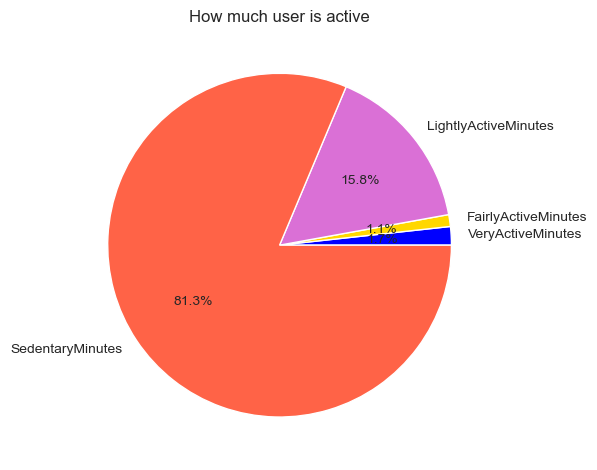

In [63]:
plt.pie(activity_avg, labels=['VeryActiveMinutes', 'FairlyActiveMinutes','LightlyActiveMinutes', 'SedentaryMinutes'],
       autopct='%1.1f%%',colors=['blue','gold','orchid','tomato'],)
plt.title('How much user is active')
plt.tight_layout()

Insight : The pie plot shows that users spent 81.3% of time in Sedentary(Unactive) state<br>
15.8% Lightly active<br>
1.1% and 1.7% in Fairly active and very active state

### Most frequent day when fit bit is used 

Text(0.5, 1.0, 'Most frequent day')

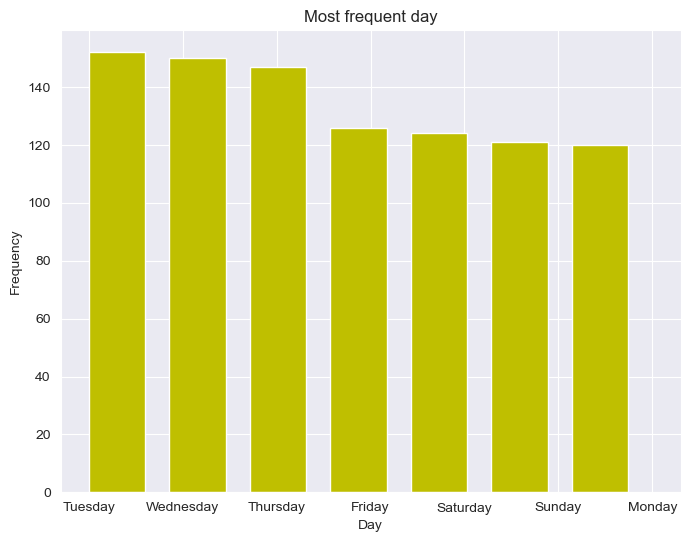

In [64]:
plt.figure(figsize=(8,6))
plt.hist(d_activity.day, color='y', bins=7, width=.6, align='mid')
plt.xlabel('Day')
plt.ylabel('Frequency')
plt.title('Most frequent day')

Insight: Fit bit record highest activity on Tuesday and Wednesday and least on Sunday and Monday

#### Average Calories burnt in days

In [65]:
## Grouping data based on the day
week = ['Sunday','Monday','Tuesday','Wednesday','Thursday','Friday','Saturday']
grouped_day = d_activity.groupby('day')[['Calories']].mean().reindex(week)
grouped_day.reset_index(inplace=True)

In [66]:
grouped_day = pd.DataFrame(grouped_day)
grouped_day

,day,Calories
0,Sunday,2263.000000
1,Monday,2324.208333
2,Tuesday,2356.013158
3,Wednesday,2302.620000
4,Thursday,2199.571429
5,Friday,2331.785714
6,Saturday,2354.967742


D:\Anaconda\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


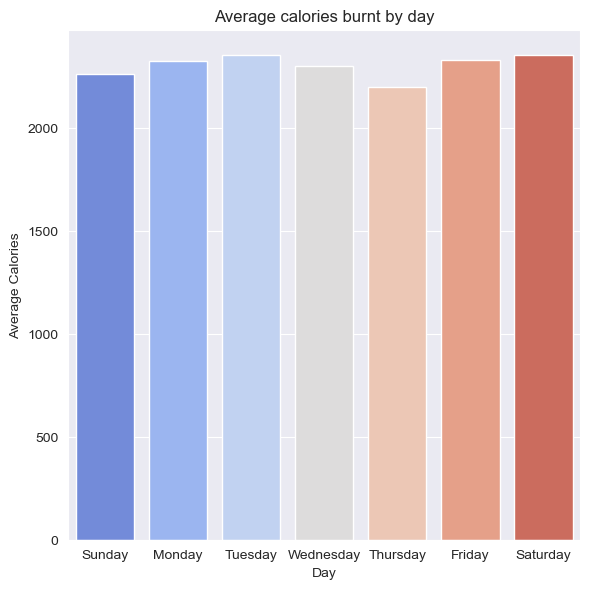

In [67]:
plt.figure(figsize=(6,6))
x = grouped_day['day']
y = grouped_day['Calories']
sns.barplot(x,y,palette='coolwarm')
plt.xlabel('Day')
plt.ylabel('Average Calories')
plt.title('Average calories burnt by day')
plt.tight_layout()

Insight : We can see Tuesday and Saturday have highest average calories burnt while Thursday has lowest 

### Average calories burnt in hours

In [68]:
df = hourly_activity.groupby('time')[['Calories']].mean()
df.reset_index(inplace=True)

In [69]:
df = pd.DataFrame(df)
df.head()

,time,Calories
0,00:00:00,71.805139
1,01:00:00,70.165059
2,02:00:00,69.186495
3,03:00:00,67.538049
4,04:00:00,68.261803


In [70]:
df['time'] = df['time'].astype(str)

D:\Anaconda\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0.5, 1.0, 'Avg calories burn per hour')

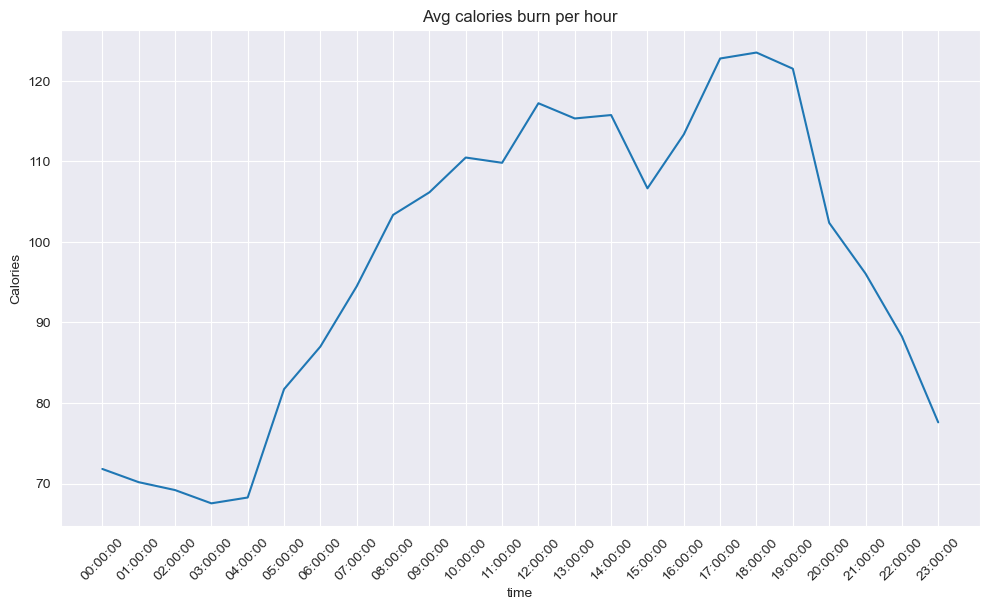

In [71]:
plt.figure(figsize=(10,6))
sns.lineplot(df['time'],df['Calories'])
plt.xticks(rotation='45')
plt.tight_layout()
plt.title('Avg calories burn per hour')

Insight : The calories burn is at peak at around 6 pm(18:00:00) and lowest at 4 am and start decreasing around 7 pm

### Average Sleep 

In [72]:
sleepday['day'] = sleepday['SleepDay'].dt.day_name()

In [73]:
df = sleepday.groupby('day')[['TotalMinutesAsleep','TotalTimeInBed']].mean()
df.reset_index(inplace=True)

In [74]:
df

,day,TotalMinutesAsleep,TotalTimeInBed
0,Friday,405.421053,445.052632
1,Monday,418.829787,456.170213
2,Saturday,420.810345,461.275862
3,Sunday,452.745455,503.509091
4,Thursday,402.369231,435.800000
5,Tuesday,404.538462,443.292308
6,Wednesday,434.681818,470.030303


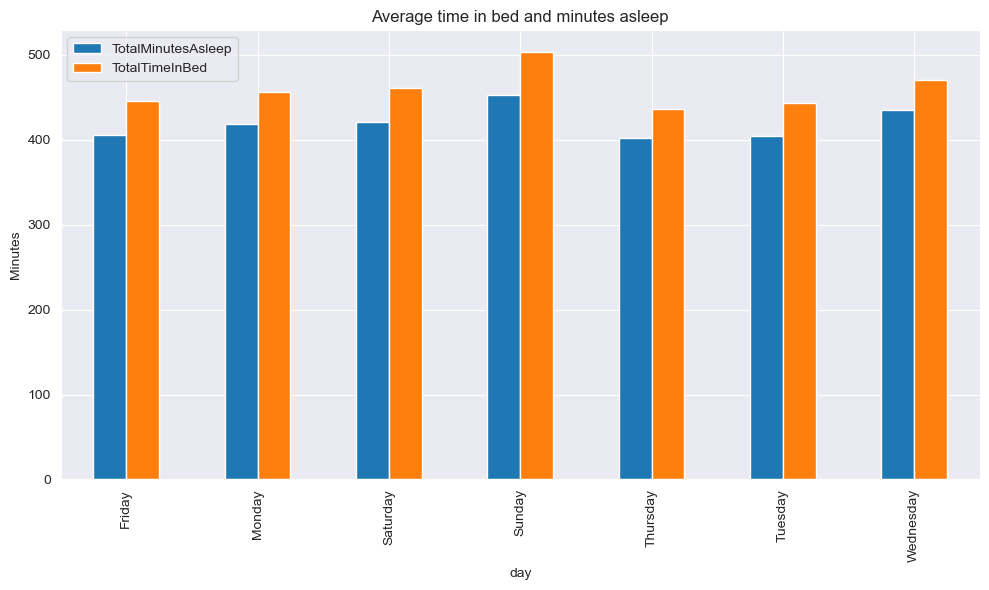

In [75]:
df.plot(x='day',kind='bar',figsize=(10,6))
plt.ylabel('Minutes')
plt.title('Average time in bed and minutes asleep')
plt.tight_layout()

Insight : More most of the time users in bed stay awake. They sleep less and spent more time awaken in bed

### Total steps taken on daily basis

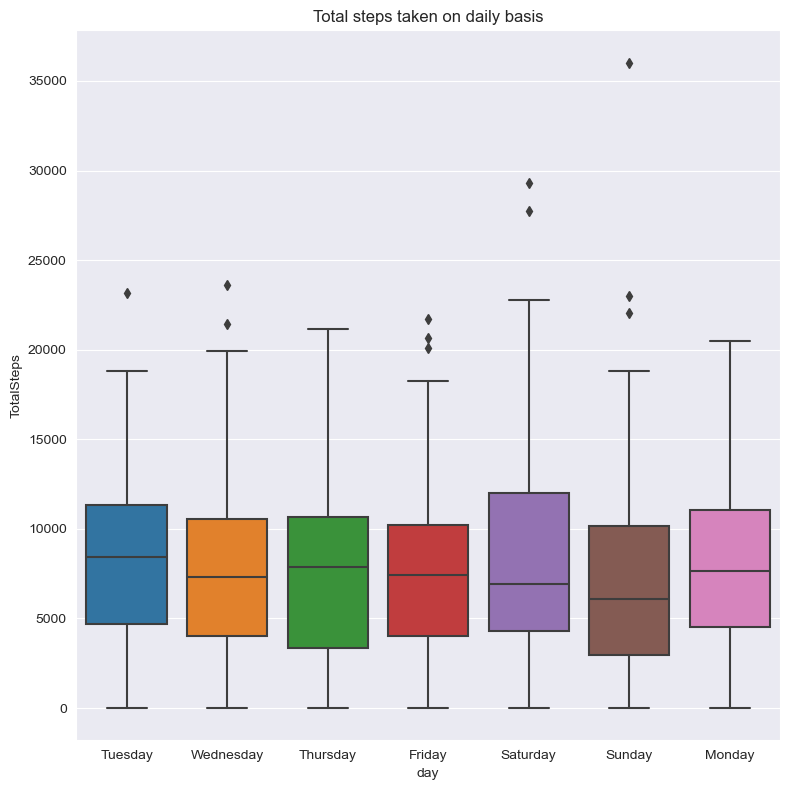

In [76]:
plt.figure(figsize = (8,8))
sns.boxplot(data=d_activity, x='day', y='TotalSteps')
plt.title('Total steps taken on daily basis')
plt.tight_layout()

Insight : We can see few outliers in the TotalSteps. Users have highset step count in Saturday and lowest at Friday

### Total steps on hourly basis

In [77]:
hourly_activity.head()

,Id,Calories,date,month,year,time,TotalIntensity,AverageIntensity,StepTotal
0,1503960366,81,12,4,2016,00:00:00,20,0.333333,373
1,1503960366,61,12,4,2016,01:00:00,8,0.133333,160
2,1503960366,59,12,4,2016,02:00:00,7,0.116667,151
3,1503960366,47,12,4,2016,03:00:00,0,0.000000,0
4,1503960366,48,12,4,2016,04:00:00,0,0.000000,0


In [78]:
df = hourly_activity.groupby('time')[['StepTotal']].mean()
df.reset_index(inplace=True)
df['time'] = df['time'].astype(str)

<Figure size 800x800 with 0 Axes>

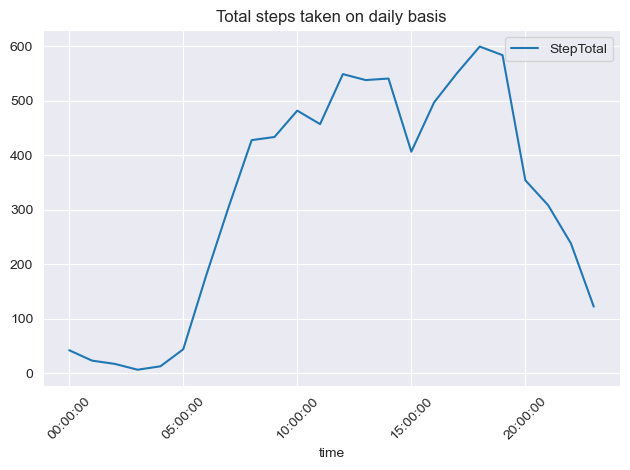

In [79]:
plt.figure(figsize = (8,8))
df.plot(x='time', y='StepTotal', kind='line')
plt.xticks(rotation='45')
plt.title('Total steps taken on daily basis')
plt.tight_layout()

### Correlation of daily activity

<AxesSubplot:>

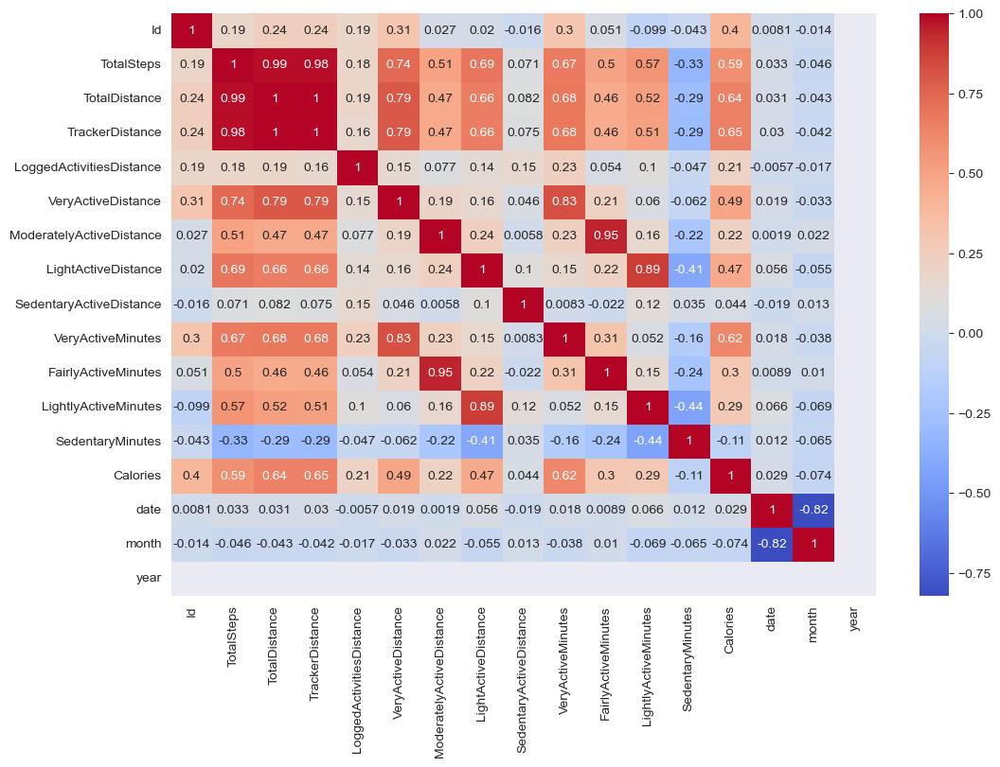

In [80]:
df = d_activity.corr()
plt.figure(figsize=(12,8))
sns.heatmap(df,annot=True,cmap='coolwarm')

Insight : Total steps have a strong positive correlation with TotalDiatance and Tracker Distance<br>
Others strong correlations are<br>
VeryActiveDistance and VeryActiveMinutes<br>
LightlyActiveMinutes and LightActiveDistance<br>
FairlyActiveMinutes and ModeratelyActiveDistance<br>
VeryActiveMinutes and VeryActiveDistance<br>
TotalSteps, TotalDistance, TrackerDistance and VeryActiveDistance

### Average Calories burn per minute

In [81]:
df = minute_activity.groupby('Id')[['Calories']].mean()

In [82]:
df.reset_index(inplace=True)

In [83]:
df['Calories'].mean()

1.6116656533045446

<AxesSubplot:xlabel='Id', ylabel='Calories'>

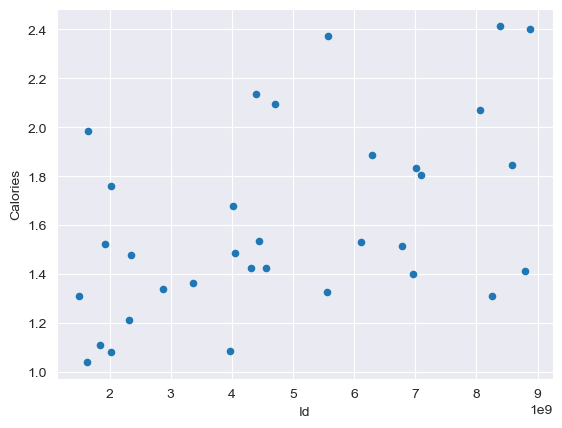

In [84]:
df.plot(kind='scatter', x='Id',y='Calories')

Insights : Per minute on an average per user burns 1.611 calories.

### Heart Rate

In [85]:
heart.groupby('Id')[['Value']].mean()

,Value
Id,
2022484408,80.236860
2026352035,93.776305
2347167796,76.722792
4020332650,82.300577
4388161847,66.132998
4558609924,81.673947
5553957443,68.633093
5577150313,69.564516
6117666160,83.749891


Insights : Out of 33 users we have only 14 users with registered Heart Rate. To find some insights i need more heart data of other users. For these Id's you can see their average heart rate.

### Weight

In [86]:
weight.groupby('Id')[['WeightKg']].mean()

,WeightKg
Id,
1503960366,52.599998
1927972279,133.500000
2873212765,57.000000
4319703577,72.350002
4558609924,69.639999
5577150313,90.699997
6962181067,61.553334
8877689391,85.145834


We have record of only 8 users which is not good for EDA or for some insights need more data.

## Automated EDA using pandas profiling

In [87]:
from ydata_profiling import profile_report

In [88]:
daily_profile = d_activity.profile_report(explorative=True)

In [89]:
daily_profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [90]:
hourly_profile = hourly_activity.profile_report(explorative=True)

In [91]:
hourly_profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [92]:
minute_profile = minute_activity.profile_report(explorative=True)

In [93]:
minute_profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Customer segmentation

### Based on Total active minute daily

In [94]:
d_activity['Total_active_minute'] = d_activity.SedentaryMinutes - (d_activity.LightlyActiveMinutes + 
                               d_activity.FairlyActiveMinutes + d_activity.VeryActiveMinutes)

Writing a function for customer segmentation:<br>
if Total_active_minute > 800 then Very active<br>
if Total_active_minute is between 600 and 800 then fairly active<br>
if Total_Active_minute is between 400 and 600 then lightly active<br>
if Total_active_minute islower than 400 then lazy<br>

In [95]:
def users_minute(Total_active_minute):
    if Total_active_minute > 800:
        return 'Very_Active'
    elif 800 > Total_active_minute > 600:
        return 'Fairly_Active'
    elif 600 > Total_active_minute > 400:
        return 'Lightly_Active'
    else:
        return 'Lazy'

In [96]:
d_activity['types'] = d_activity['Total_active_minute'].apply(users_minute)

In [97]:
df = d_activity.groupby('Id')[['types']].agg(lambda x:x.mode().iloc[0])

<AxesSubplot:xlabel='types', ylabel='count'>

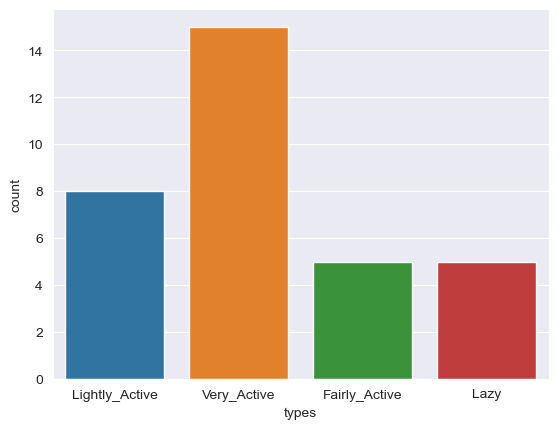

In [98]:
sns.countplot(data=df, x='types')

As you can see there are:<br>
15 very active users<br>
8 Lightly active users<br>
5 fairly active users<br>
5 Lazy users on daily basis

### Based on Average Sleep

for determining the total minutes users sleep= TotalMinutesAsleep

In [99]:
sleepday.head()

,Id,SleepDay,TotalSleepRecords,TotalMinutesAsleep,TotalTimeInBed,day,month,year
0,1503960366,2016-04-12,1,327,346,Tuesday,4,2016
1,1503960366,2016-04-13,2,384,407,Wednesday,4,2016
2,1503960366,2016-04-15,1,412,442,Friday,4,2016
3,1503960366,2016-04-16,2,340,367,Saturday,4,2016
4,1503960366,2016-04-17,1,700,712,Sunday,4,2016


For TotalMinutesAsleep:<br>
more than 420 minutes or 7 hrs for Good sleep<br>
between 300 and 420 minutes for sufficient sleep<br>
less than 300 minutes for Insufficient sleep

In [100]:
def users_sleep(TotalMinutesAsleep):
    if TotalMinutesAsleep >= 420:
        return 'Good_Sleep'
    elif 300 < TotalMinutesAsleep < 420:
        return 'Sufficient_Sleep'
    else:
        return 'Insufficient_Sleep'

In [101]:
sleepday['sleep_type'] = sleepday['TotalMinutesAsleep'].apply(users_sleep)

In [102]:
sleepday.head()

,Id,SleepDay,TotalSleepRecords,TotalMinutesAsleep,TotalTimeInBed,day,month,year,sleep_type
0,1503960366,2016-04-12,1,327,346,Tuesday,4,2016,Sufficient_Sleep
1,1503960366,2016-04-13,2,384,407,Wednesday,4,2016,Sufficient_Sleep
2,1503960366,2016-04-15,1,412,442,Friday,4,2016,Sufficient_Sleep
3,1503960366,2016-04-16,2,340,367,Saturday,4,2016,Sufficient_Sleep
4,1503960366,2016-04-17,1,700,712,Sunday,4,2016,Good_Sleep


Grouping by Id and most occuring sleep type

In [103]:
df = sleepday.groupby('Id')[['sleep_type']].agg(lambda x:x.mode().iloc[0])

<AxesSubplot:xlabel='sleep_type', ylabel='count'>

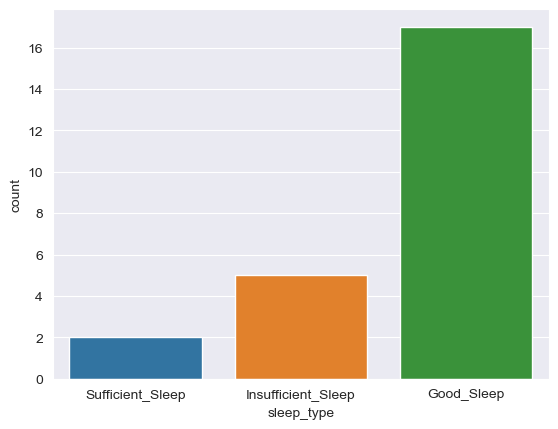

In [104]:
sns.countplot(data =df, x='sleep_type')

On an average 17 users have a good sleep per day<br>
There are 5 users with Insufficient Sleep<br>
There are 2 users with Sufficient Sleep

### Based on Average Total steps taken daily

For total taken on daily basis:<br>
more than 8000 steps is Impressive <br>
between 6000 and 8000 is Ok<br>
less than 6000 is need more<br>

In [105]:
def users_steps(TotalSteps):
    if TotalSteps > 8000:
        return 'Impressive'
    elif 6000 < TotalSteps <8000:
        return 'Ok'
    else:
        return 'need_more'

In [106]:
d_activity['users_steps'] = d_activity['TotalSteps'].apply(users_steps)

In [107]:
df = d_activity.groupby('Id')[['users_steps']].agg(lambda x:x.mode().iloc[0])

<AxesSubplot:xlabel='users_steps', ylabel='count'>

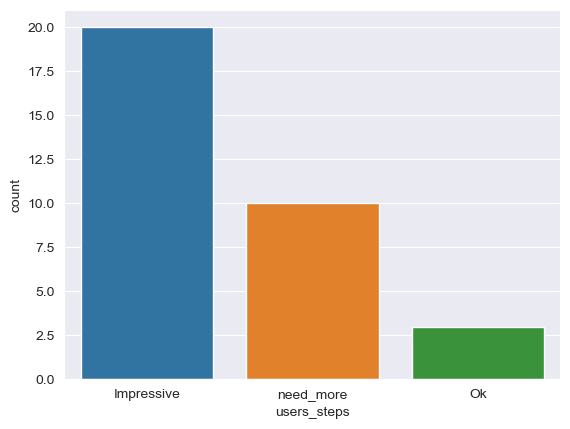

In [108]:
sns.countplot(data=df, x='users_steps')

There are 20 users with average step taken more than 8000<br>
There are 10 users that needs to walk more<br>
There are 3 users with steps between 6000 to 8000 steps.

## Business Solution

1. Fit Bit Should send personalised notifications to encourage the users to stay active.
2. Should also send Sleep notification to users to remind them not to stay awake for long time.
3. Average steps are 7520 which is low. We can introduce friendly competiton between the users to encourage them to walk more.
4. We can add recommended sleep hours based on their daily activity.
5. Add Sedentary Minutes limit and ring a alarm when users reached the limit.
6. Daily Motivational Quotes.
7. Offer Excercise modes for them.